In [1]:
import sys
from pathlib import Path

from tifffile import imread
from tqdm import tqdm

import numpy as np
import torch

from scipy.ndimage import zoom


sys.path.insert(0, "../utils")
from norm_percentile_nocrop import norm_percentile_nocrop
from utils.predict_by_parts import predict_by_parts
from utils.organized import split_nuclei, balloon

src_path = Path(
    "/Users/pszyc/Library/CloudStorage/GoogleDrive-przemek.7678@gmail.com/My Drive/Studia/Ogniska/NHDF/"
)
model_path = "segmentation_model.pt"
img_folders = sorted(src_path.glob("*"))


resized_img_size = [505, 681, 48]  # image is resized to this size
normalization_percentile = 0.0001  # image is normalized into this percentile range
mask_erosion = [14, 14, 5]  # amount of mask erosion (elipsoid)

minimal_nuclei_size = 10000
h = 2
min_dist = 35

crop_size = [96, 96]

device = torch.device("cpu")

X, Y, Z = np.meshgrid(
    np.linspace(-1, 1, mask_erosion[0]),
    np.linspace(-1, 1, mask_erosion[1]),
    np.linspace(-1, 1, mask_erosion[2]),
)
sphere = np.sqrt(X**2 + Y**2 + Z**2) < 1


model = torch.load(model_path, map_location=torch.device("cpu"))


def predict_nn(data_path):
    img_path = data_path / "data_53BP1.tif"
    img_filename = str(img_path)
    img = []
    img.append(imread(img_filename))  # red
    img.append(imread(img_filename.replace("53BP1", "gH2AX")))  # green
    img.append(imread(img_filename.replace("53BP1", "DAPI")))  # DAPI
    img = np.stack(img, axis=3)

    original_img_size = img.shape[:3]

    factor = np.array(resized_img_size) / np.array(original_img_size)

    tmp_size = resized_img_size.copy()
    tmp_size.append(img.shape[3])
    img_resized = np.zeros(tmp_size, dtype=np.float32)
    for channel in range(img.shape[3]):

        data_one_channel = img[..., channel]

        data_one_channel = zoom(data_one_channel, factor, order=1)
        data_one_channel = norm_percentile_nocrop(
            data_one_channel, normalization_percentile
        )

        img_resized[..., channel] = data_one_channel

    img = img_resized

    img = img.astype(np.float32)
    img = np.transpose(img, (3, 0, 1, 2)).copy()
    img = torch.from_numpy(img)
    img = img.to(device)

    mask_predicted = predict_by_parts(model, img, crop_size=crop_size)
    mask_predicted = mask_predicted.detach().cpu().numpy()[0, :, :, :]
    mask_predicted -= mask_predicted.min()
    mask_predicted /= mask_predicted.max()
    return mask_predicted, original_img_size


data_files = list(src_path.rglob("00*"))

data_files = [path for path in data_files if not (path / "nuclei_mask.npy").exists()]
print(len(data_files))

/Users/pszyc/Code/Science/OgniskaNaprawcze/confocal/DeepFoci/python/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


199


In [2]:
data_path = data_files[0]

In [3]:
data_path

PosixPath('/Users/pszyc/Library/CloudStorage/GoogleDrive-przemek.7678@gmail.com/My Drive/Studia/Ogniska/NHDF/NHDF_8h PI/IR 4Gy_8h PI/0030')

In [4]:
output_path = data_path / "nuclei_mask.npy"
mask_predicted, original_img_size = predict_nn(data_path)

100%|██████████| 63/63 [00:57<00:00,  1.09it/s]


In [5]:
from skimage.segmentation import watershed
from skimage.morphology import h_maxima
from skimage.morphology import remove_small_objects
from skimage.morphology import remove_small_holes
from skimage.feature import peak_local_max

from scipy.ndimage import binary_erosion
from scipy.ndimage import binary_dilation
from scipy.ndimage import label
from utils.organized import bwdist, bwdistgeodesic

In [6]:
mask = mask_predicted > 0.5

In [7]:
# --- Mask cleanup ---
# Remove tiny objects and fill small holes to stabilize the distance transform.
mask = remove_small_objects(mask, minimal_nuclei_size)
mask = remove_small_holes(mask, minimal_nuclei_size)
print("split_nuclei: cleanup done, mask voxels=", int(np.count_nonzero(mask)))

# --- Distance transform ---
# Compute distance inside the mask. If voxels are anisotropic, you would pass
# different weights, but here it's isotropic (1,1,1).
D = bwdist(mask, diminsion_weights=(1, 1, 1))
print("split_nuclei: distance map ready, max=", float(np.max(D)))

# --- Seed detection ---
# 1) Suppress shallow maxima (noise).
maxima2 = h_maxima(D, h)
print("split_nuclei: h_maxima done, voxels=", int(np.count_nonzero(maxima2)))

# 2) Enforce that peaks are at least `min_dist` apart.
peak_idx = peak_local_max(D, min_distance=min_dist, exclude_border=False)
maxima1 = np.zeros_like(D, dtype=bool)
maxima1[tuple(peak_idx.T)] = True
print("split_nuclei: peak_local_max done, peaks=", int(len(peak_idx)))

# Combine both criteria for more robust seeds.
labeled_maxima, num = label(maxima1 & maxima2)
print("split_nuclei: labeled maxima, count=", int(num))

# --- First watershed split ---
# Watershed on -D splits objects at narrow necks between distance peaks.
labels = watershed(-D, labeled_maxima, mask=mask, watershed_line=True)
print("split_nuclei: first watershed done, labels=", int(labels.max()))

# Keep only sufficiently large seed regions (removes spurious splits).
seeds = remove_small_objects(labels > 0, 30000)
print("split_nuclei: seed size filter done, voxels=", int(np.count_nonzero(seeds)))

# Slight erosion to separate touching seeds before geodesic refinement.
seeds = binary_erosion(seeds)
print("split_nuclei: seed erosion done, voxels=", int(np.count_nonzero(seeds)))

# --- Geodesic refinement ---
# Compute geodesic distances from seeds constrained to the original mask.
DD = bwdistgeodesic(seeds, mask, diminsion_weights=[1, 1, 1])
print("split_nuclei: geodesic distance ready, max=", float(np.max(DD)))

# Label each seed component to use as distinct watershed markers.
labeled_seeds, num = label(seeds)
print("split_nuclei: labeled seeds, count=", int(num))

split_nuclei: cleanup done, mask voxels= 652539
split_nuclei: distance map ready, max= 15.610928497064997
split_nuclei: h_maxima done, voxels= 3
split_nuclei: peak_local_max done, peaks= 4
split_nuclei: labeled maxima, count= 3
split_nuclei: first watershed done, labels= 3
split_nuclei: seed size filter done, voxels= 652539
split_nuclei: seed erosion done, voxels= 582351
split_nuclei: geodesic distance ready, max= inf
split_nuclei: labeled seeds, count= 3


In [8]:
import numpy as np
import imageio.v2 as imageio

# Choose which mask to visualize:
# mask_to_show = mask
mask_to_show = mask  # change to mask_final if you want labeled mask

gif_path = "mask_slices.gif"

H, W, Z = mask_to_show.shape
frames = []
for z in range(Z):
    sl = mask_to_show[:, :, z].astype(np.uint8) * 255  # 0 or 255
    rgba = np.stack([sl, sl, sl, np.full_like(sl, 255)], axis=2)  # grayscale RGBA
    frames.append(rgba)

imageio.mimsave(gif_path, frames, duration=0.08)
gif_path

'mask_slices.gif'

In [9]:
mask_split = watershed(DD, labeled_seeds, mask=mask, watershed_line=True)

In [10]:
# mask_split = split_nuclei(
#     mask_predicted > 0.75, minimal_nuclei_size, h, sphere, min_dist
# )

mask_label_dilated = balloon(mask_split, sphere)

factor = np.array(original_img_size) / np.array(mask_label_dilated.shape)
mask_final = zoom(mask_label_dilated, factor, order=0)

/var/folders/4q/tfzvg1g50hd89pj_w0mm6tn40000gn/T/ipykernel_83696/3803325737.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_lbl = cm.get_cmap("nipy_spectral")


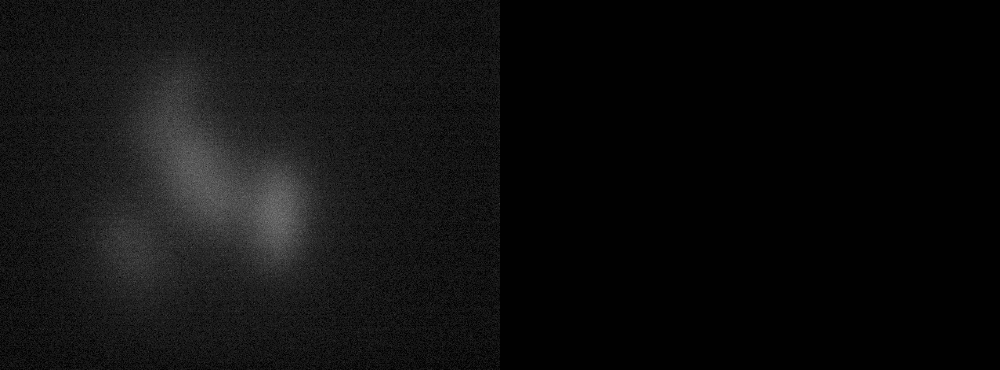

'mask_vs_original_slices.gif'

In [11]:
import numpy as np
import imageio.v2 as imageio
import matplotlib.cm as cm
from IPython.display import Image, display
from tifffile import imread

# Side-by-side GIF: original (left) + predicted labels (right)
gif_path = "mask_vs_original_slices.gif"

# Load an "original" image volume to show next to the mask.
# Default: DAPI channel, fallback to 53BP1 if DAPI is missing.
orig_path = data_path / "data_DAPI.tif"
if not orig_path.exists():
    orig_path = data_path / "data_53BP1.tif"
orig = imread(str(orig_path))

H, W, Z = mask_final.shape

# Colormap for labels (right panel)
vmax_lbl = float(np.max(mask_final))
if vmax_lbl <= 0:
    vmax_lbl = 1.0
cmap_lbl = cm.get_cmap("nipy_spectral")

# Normalize original (left panel) to 0..255 for display
orig = orig.astype(np.float32)
p1, p99 = np.percentile(orig, [1, 99])
if p99 <= p1:
    p1, p99 = float(np.min(orig)), float(np.max(orig) if np.max(orig) > np.min(orig) else np.min(orig) + 1.0)

frames = []
for z in range(Z):
    # Left: original slice -> RGBA
    sl0 = orig[:, :, z]
    sl0 = (sl0 - p1) / (p99 - p1)
    sl0 = np.clip(sl0, 0, 1)
    gray = (sl0 * 255).astype(np.uint8)
    left_rgba = np.stack([gray, gray, gray, np.full_like(gray, 255)], axis=2)

    # Right: label slice -> RGBA
    sl1 = (mask_final[:, :, z].astype(np.float32) / vmax_lbl)
    right_rgba = (cmap_lbl(sl1) * 255).astype(np.uint8)  # (H, W, 4)

    # Concatenate side-by-side
    frame = np.concatenate([left_rgba, right_rgba], axis=1)
    frames.append(frame)

imageio.mimsave(gif_path, frames, duration=0.08)
display(Image(filename=gif_path))
gif_path